In [1]:
import folium
import pandas as pd
import h3
from shapely.geometry import Polygon, Point
import shapely.wkt
from geojson import Point, Feature, FeatureCollection, dump
import seaborn as sns
from matplotlib import pyplot
from dateutil.parser import parse

# Discriptive Analysis

# Prices

In [2]:
dfPrices = pd.read_csv("auction_spot_germany_luxembourg_2019.csv",skiprows=1,sep=';')
dfPrices

,Delivery day,Hour1,Hour2,Hour3A,Hour3B,Hour4,Hour5,Hour6,Hour7,Hour8,...,Peakload\n(09-20),Night\n(01-06),Off-Peak 1\n(01-08),Business\n(09-16),Off-Peak\n(01-08 & 21-24),Morning\n(07-10),High Noon\n(11-14),Afternoon\n(15-18),Evening\n(19-24),Sun Peak\n(11-16)
0,31.12.2019,"24,14","22,12","13,01",NaN,"4,97","9,81","18,37","23,50","27,17",...,"40,36","15,40","17,89","37,78","25,11","31,92","36,93","41,48","41,99","37,55"
1,30.12.2019,"11,07","11,84","6,16",NaN,"1,40","4,81","16,43","26,90","30,38",...,"32,52","8,62","13,62","30,75","18,61","30,31","29,23","34,62","30,88","30,34"
2,29.12.2019,"30,60","28,10","26,92",NaN,"22,85","20,97","21,31","22,72","25,10",...,"33,30","25,13","24,82","30,67","27,03","26,35","31,04","34,29","34,42","31,31"
3,28.12.2019,"30,17","29,50","29,43",NaN,"28,20","28,53","27,40","29,20","31,63",...,"37,42","28,87","29,26","35,17","31,17","33,07","34,79","37,86","37,83","34,99"
4,27.12.2019,"31,17","30,02","28,67",NaN,"28,70","29,19","31,03","33,10","38,89",...,"42,64","29,80","31,35","40,86","32,99","37,64","40,26","45,81","39,00","41,39"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,05.01.2019,"26,90","25,12","24,12",NaN,"22,04","18,37","22,09","23,35","28,76",...,"51,30","23,11","23,84","47,62","33,06","32,30","49,69","54,67","54,51","50,65"
361,04.01.2019,"50,73","47,11","47,07",NaN,"46,94","47,00","46,91","49,59","55,32",...,"53,32","47,63","48,83","53,32","46,50","54,05","53,04","52,59","45,56","52,54"
362,03.01.2019,"42,91","45,22","45,63",NaN,"44,00","43,88","45,92","51,07","52,77",...,"65,00","44,59","46,43","63,16","50,43","56,69","62,34","67,74","61,76","63,73"
363,02.01.2019,"-33,57","-45,92","-48,29",NaN,"-44,99","-48,93","-29,91","-0,01","37,43",...,"51,39","-41,94","-26,77","47,44","0,44","34,06","44,36","54,07","57,29","46,79"


In [3]:
dfOnlyPrices = pd.DataFrame()

for column in dfPrices.columns:
    if 'Hour' in column and 'Rush' not in column:
        dfOnlyPrices[column] = dfPrices[column].str.replace(",",".").astype(float)

dfOnlyPrices.drop('Hour3B',axis=1,inplace=True)
dfOnlyPrices.rename(columns={'Hour3A':'Hour3'},inplace=True)
dfOnlyPrices.head()

,Hour1,Hour2,Hour3,Hour4,Hour5,Hour6,Hour7,Hour8,Hour9,Hour10,...,Hour15,Hour16,Hour17,Hour18,Hour19,Hour20,Hour21,Hour22,Hour23,Hour24
0,24.14,22.12,13.01,4.97,9.81,18.37,23.50,27.17,36.56,40.43,...,38.00,39.58,42.28,46.06,47.73,46.00,42.20,39.74,38.88,37.39
1,11.07,11.84,6.16,1.40,4.81,16.43,26.90,30.38,32.04,31.90,...,31.53,33.61,35.25,38.09,39.35,31.58,30.68,29.67,29.68,24.33
2,30.60,28.10,26.92,22.85,20.97,21.31,22.72,25.10,27.52,30.04,...,30.80,32.86,33.97,39.53,41.16,39.60,38.14,32.00,30.11,25.52
3,30.17,29.50,29.43,28.20,28.53,27.40,29.20,31.63,34.61,36.82,...,34.91,35.86,39.86,40.79,43.75,43.29,39.62,35.39,34.75,30.17
4,31.17,30.02,28.67,28.70,29.19,31.03,33.10,38.89,38.55,40.00,...,42.20,45.13,46.53,49.38,44.88,43.99,39.52,36.67,35.38,33.57


Text(0.5, 1.0, 'Energy Prices')

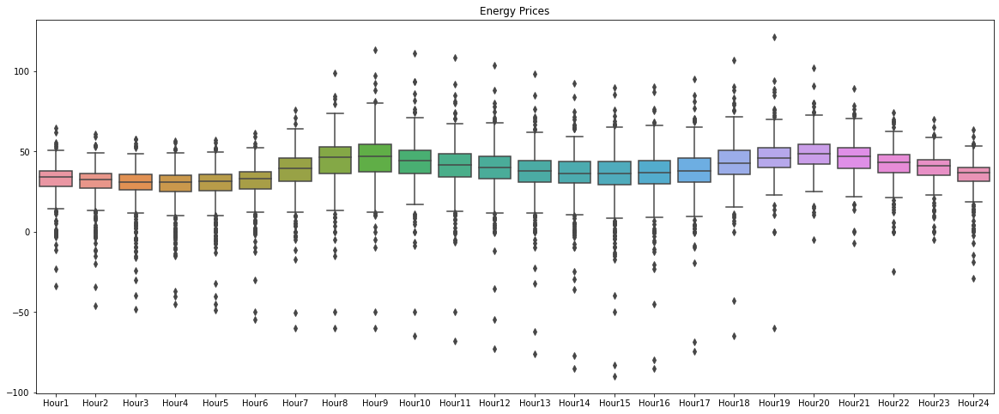

In [4]:
fig, ax = pyplot.subplots(figsize=(20, 8))
sns.boxplot(ax=ax, data=dfOnlyPrices).set_title('Energy Prices')

Text(0.5, 1.0, 'Energy Prices')

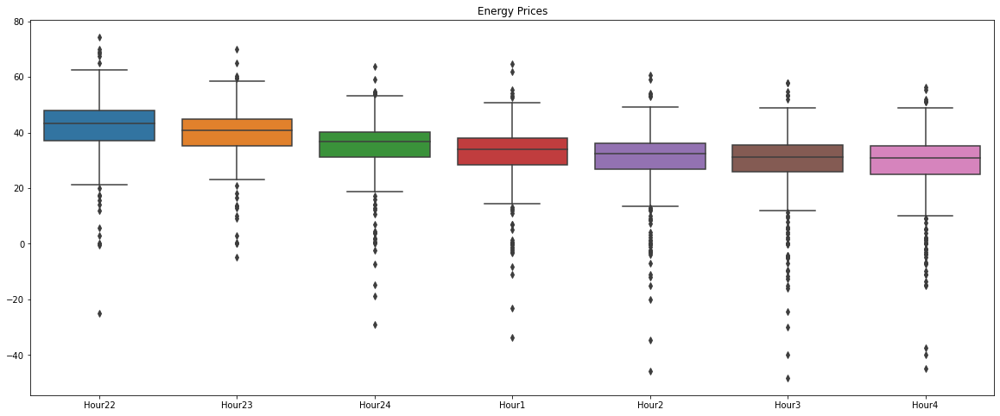

In [5]:
dfSelection = dfOnlyPrices[['Hour22','Hour23','Hour24','Hour1','Hour2','Hour3','Hour4']]
fig, ax = pyplot.subplots(figsize=(20, 8))
sns.boxplot(ax=ax, data=dfSelection).set_title('Energy Prices')

# Demand Data

### Create a GeoJson

In [6]:
def output_h3_id_attributes(h3_id):
    return Polygon(h3.h3_to_geo_boundary(h3_id, geo_json=True))


dfDemand = pd.read_csv('sharenow_supply_data_6mo.csv')

list_EndUnique = list(dfDemand['hex_end_7'].unique())

features = []
for hexID in list_EndUnique:
    features.append(Feature(geometry=output_h3_id_attributes(hexID), properties={"hexID": hexID}))

feature_collection = FeatureCollection(features)

with open('berlin_hexagons.geojson', 'w') as f:
   dump(feature_collection, f)

In [7]:
hours = []
for value in dfDemand['datetime_start'].values:
    dt = parse(value)
    hours.append(dt.time().hour)
dfDemand['hour_start'] = hours

hours = []
for value in dfDemand['datetime_end'].values:
    dt = parse(value)
    hours.append(dt.time().hour)
dfDemand['hour_end'] = hours

# Visulise

## Map _ Average Trip ends

In [8]:
avgDrives = dfDemand.value_counts('hex_end_7')/len(dfDemand['date_start'].unique())
dfAvgDrives = pd.DataFrame(avgDrives,columns=['avgTrips']).reset_index()
dfAvgDrives = dfAvgDrives.rename(columns={'hex_end_7':'hexID'})
dfAvgDrives

,hexID,avgTrips
0,871f1d4d0ffffff,99.687861
1,871f1d4f2ffffff,85.826590
2,871f18b21ffffff,76.485549
3,871f1d4d2ffffff,68.520231
4,871f1d4d4ffffff,66.127168
...,...,...
92,871f1d495ffffff,0.005780
93,871f1886affffff,0.005780
94,871f18b01ffffff,0.005780
95,871f1d4adffffff,0.005780


In [9]:
f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=dfAvgDrives, 
             columns=['hexID', 'avgTrips'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Average Trip Ends per Day')
f.add_child(map)

### Single hours

In [10]:
hour = 23
df = dfDemand[dfDemand['hour_end']==hour]
df = df[df['fuel_end'] < 50]

avgDrives = df.value_counts('hex_end_7')/len(df['date_start'].unique())
dfAvgDrives = pd.DataFrame(avgDrives,columns=['avgTrips']).reset_index()
dfAvgDrives = dfAvgDrives.rename(columns={'hex_end_7':'hexID'})

#Avoid black points 
#Get all hex ids
possibleIds = dfDemand.hex_end_7.unique()

for id in possibleIds:
    if id not in dfAvgDrives['hexID'].unique():
        dfAvgDrives = dfAvgDrives.append({'hexID':id,'avgTrips':0},ignore_index=True)

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=dfAvgDrives, 
             columns=['hexID', 'avgTrips'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Average Trip Ends per Day at {} a.m., SoC < 50%'.format(str(hour)))
f.add_child(map)

## Map _ Scenarios

In [11]:
dfScenarios = pd.read_csv('scenarios_multinomial.csv')
dfScenarios

,871f1d4d0ffffff,871f1d48affffff,871f1d48effffff,871f1d499ffffff,871f18b25ffffff,871f1d4f0ffffff,871f1d4d2ffffff,871f1d49bffffff,871f1d49dffffff,871f1d483ffffff,...,871f18b01ffffff,871f1d4adffffff,871f18868ffffff,871f1d4c4ffffff,871f18b11ffffff,871f1d4c0ffffff,871f18b28ffffff,871f18b71ffffff,871f1886affffff,probs
0,0.0,0.0,0.0,3.0,0.0,5.0,0.0,0.0,0.0,4.0,...,3.0,4.0,4.0,4.0,2.0,24.0,7.0,4.0,12.0,0.013
1,1.0,0.0,0.0,9.0,0.0,3.0,0.0,0.0,0.0,6.0,...,3.0,1.0,5.0,2.0,1.0,24.0,6.0,4.0,9.0,0.162
2,1.0,2.0,0.0,8.0,0.0,5.0,0.0,0.0,0.0,8.0,...,0.0,0.0,3.0,6.0,2.0,32.0,5.0,4.0,15.0,0.204
3,1.0,0.0,0.0,9.0,0.0,3.0,0.0,0.0,0.0,3.0,...,0.0,1.0,3.0,6.0,1.0,22.0,6.0,2.0,17.0,0.621


In [12]:
df1 = dfScenarios.iloc[0]
df1 = df1.T
df1 = df1.reset_index()
df1 = df1.rename(columns={'index':'hexID',0:'low_soc_cars'})
df1 = df1[df1['hexID']!='probs']

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df1, 
             columns=['hexID', 'low_soc_cars'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='#Cars with SoC < 50%')
f.add_child(map)

In [13]:
df1 = dfScenarios.iloc[1]
df1 = df1.T
df1 = df1.reset_index()
df1 = df1.rename(columns={'index':'hexID',1:'low_soc_cars'})
df1 = df1[df1['hexID']!='probs']

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df1, 
             columns=['hexID', 'low_soc_cars'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='#Cars with SoC < 50%')
f.add_child(map)

In [14]:
df1 = dfScenarios.iloc[2]
df1 = df1.T
df1 = df1.reset_index()
df1 = df1.rename(columns={'index':'hexID',2:'low_soc_cars'})
df1 = df1[df1['hexID']!='probs']

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df1, 
             columns=['hexID', 'low_soc_cars'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='#Cars with SoC < 50%')
f.add_child(map)

In [15]:
df1 = dfScenarios.iloc[3]
df1 = df1.T
df1 = df1.reset_index()
df1 = df1.rename(columns={'index':'hexID',3:'low_soc_cars'})
df1 = df1[df1['hexID']!='probs']

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df1, 
             columns=['hexID', 'low_soc_cars'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='#Cars with SoC < 50%')
f.add_child(map)

## Map _ Chargers (Model results)

In [16]:
chargerPerHex = pd.read_csv('charger_in_hex.csv')
finalData = chargerPerHex[['hexID']]
chargerPerHex = chargerPerHex[['x1','x2','x3']].sum(axis=1)
finalData['charger'] = chargerPerHex

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=finalData, 
             columns=['hexID', 'charger'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Charger')
f.add_child(map)

In [17]:
## Probabiliteis by mult. distribution

In [18]:
chargerPerHex = pd.read_csv('probs.csv')
chargerPerHex

,prob,hexID
0,0.000479,871f1d4d0ffffff
1,0.000632,871f1d48affffff
2,0.000000,871f1d48effffff
3,0.010328,871f1d499ffffff
4,0.000000,871f18b25ffffff
...,...,...
92,0.001805,871f18b11ffffff
93,0.045309,871f1d4c0ffffff
94,0.010868,871f18b28ffffff
95,0.007555,871f18b71ffffff


In [19]:
chargerPerHex = pd.read_csv('probs.csv')
chargerPerHex

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=chargerPerHex, 
             columns=['hexID', 'prob'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='prob')
f.add_child(map)

# Further Visualization

In [20]:
df = pd.read_csv('sharenow_supply_data_6mo.csv')

In [21]:
df['duration_mins_rounded'] = round(df['duration_mins'],0)

Text(0.5, 1.0, 'Trip Duration')

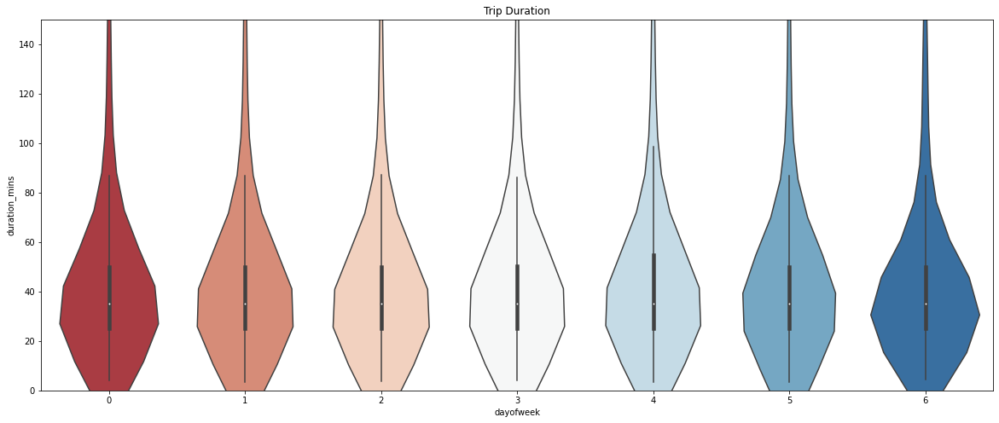

In [22]:
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set(ylim=(0,150))
sns.violinplot(ax=ax, data=df, x='dayofweek',y='duration_mins',palette=sns.color_palette("RdBu", 7)).set_title('Trip Duration')

In [23]:
hours = []
for value in df['datetime_start'].values:
    dt = parse(value)
    hours.append(dt.time().hour)
df['hour_start'] = hours

hours = []
for value in df['datetime_end'].values:
    dt = parse(value)
    hours.append(dt.time().hour)
df['hour_end'] = hours

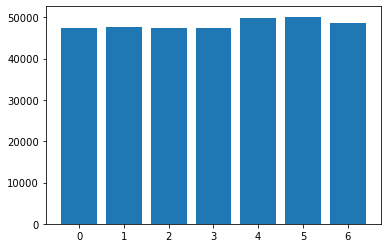

In [24]:
dfNew = pd.DataFrame(df.value_counts('dayofweek')).reset_index()
dfNew = dfNew.rename(columns={0:'#drives'})
pyplot.bar(dfNew['dayofweek'],dfNew['#drives'])
pyplot.titel = "Trips per Weekday"

pyplot.show()

Text(0.5, 1.0, 'Number of Trips per Weekday')

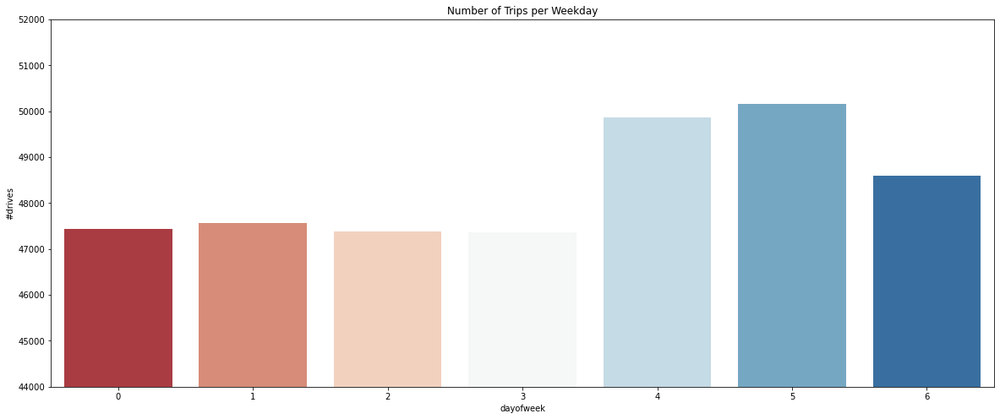

In [25]:
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set(ylim=(44000,52000))
sns.barplot(ax=ax, data = dfNew, x= 'dayofweek', y=dfNew['#drives'], palette=sns.color_palette("RdBu", 7)).set_title('Number of Trips per Weekday')

In [26]:
import numpy as np

Text(0.5, 1.0, 'Trip Start Times')

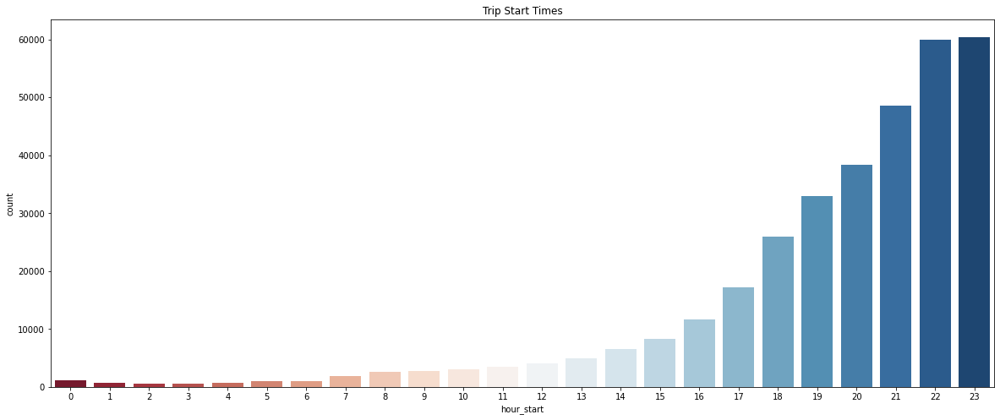

In [27]:
fig, ax = pyplot.subplots(figsize=(20, 8))

sns.countplot(data=df, x='hour_start',palette=sns.color_palette("RdBu", 24)).set_title('Trip Start Times')


Text(0.5, 1.0, 'Duration')

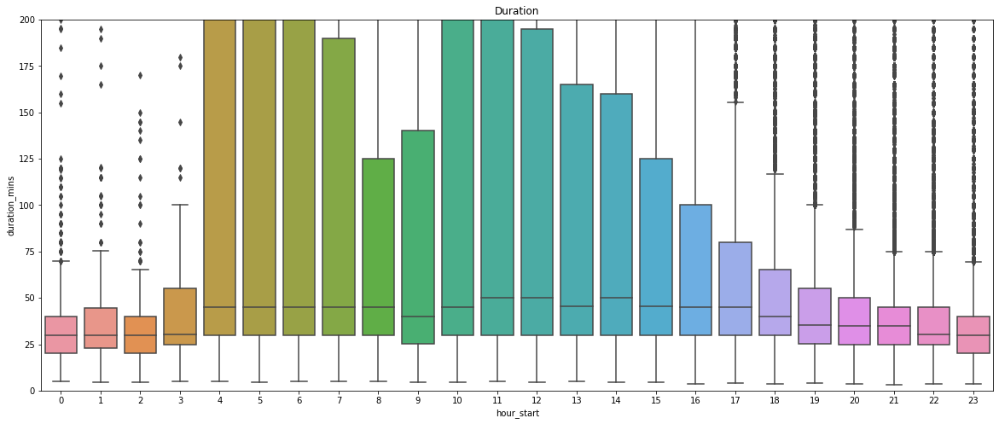

In [28]:
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set(ylim=(0,200))
sns.boxplot(ax=ax, data=df, x='hour_start',y='duration_mins').set_title('Duration')

In [29]:
df2 = pd.DataFrame(df.value_counts('hour_start'),columns=['#drives'])
df2 = df2.reset_index()
df2 = df2.sort_values('hour_start')

Text(0.5, 1.0, 'Number of Trips per Weekday')

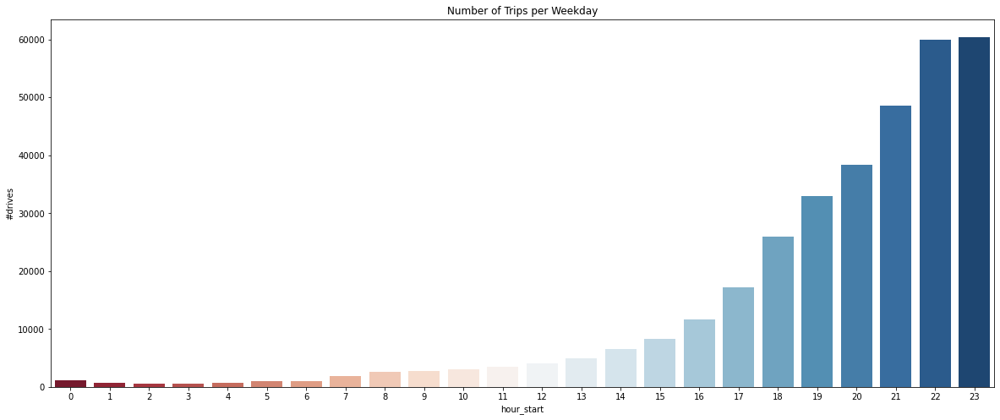

In [30]:
fig, ax = pyplot.subplots(figsize=(20, 8))
#ax.set(ylim=(44000,52000))
sns.barplot(ax=ax, data = df2, x= 'hour_start', y='#drives', palette=sns.color_palette("RdBu", 24)).set_title('Number of Trips per Weekday')

<BarContainer object of 24 artists>

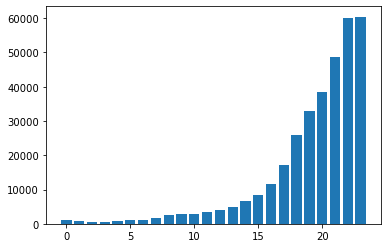

In [31]:
pyplot.bar(df2['hour_start'],df2['#drives'])

([0, 1, 2, 3, 4, 5, 6, 7, 8],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

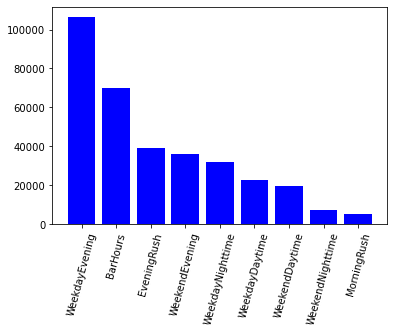

In [32]:
df3 = pd.DataFrame(df.value_counts('time_basket'),columns=['#drives'])
df3 = df3.reset_index()

pyplot.bar(df3['time_basket'],df3['#drives'],color='blue')
pyplot.xticks(rotation=75)

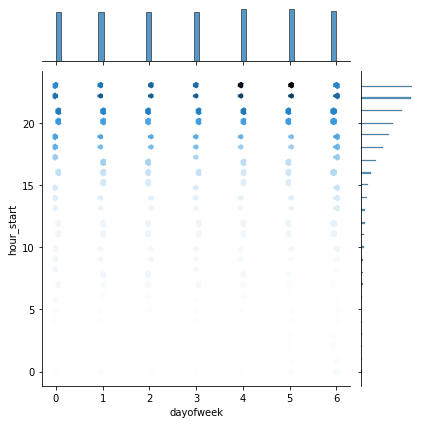

In [33]:
sns.jointplot(data=df, x="dayofweek", y="hour_start",kind='hex')

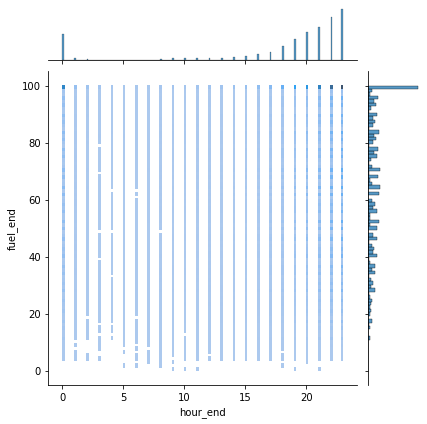

In [34]:
sns.jointplot(data=df, x="hour_end", y="fuel_end",kind='hist')

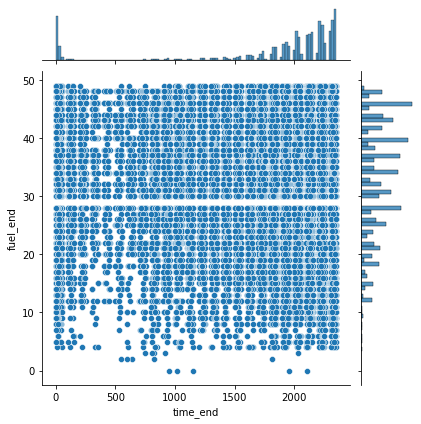

In [35]:
lowFuel = df[df['fuel_end'] < 50]
sns.jointplot(data=lowFuel, x="time_end", y="fuel_end", palette=sns.color_palette("RdBu"))